## Summary

L’objectif de ce projet est de construire et comparer différents modèles de régression linéaire afin de prédire la valeur médiane des logements en Californie à partir de caractéristiques socio-économiques et géographiques.


**Description des variables du dataset**

- `longitude` : Coordonnée géographique ouest-est du district (plus la valeur est négative, plus on est à l’ouest, proche de l’océan Pacifique).
- `latitude` : Coordonnée géographique nord-sud du district (plus la valeur est grande, plus on est au nord de la Californie).
- `housing_median_age` : Âge médian des logements du district (en années). Donne une idée de l’ancienneté du parc immobilier.
- `total_rooms` : Nombre total de pièces (rooms) pour l’ensemble des logements du district.
- `total_bedrooms` : Nombre total de chambres (bedrooms) pour l’ensemble des logements du district.
- `population` : Nombre total d’habitants dans le district.
- `households` : Nombre total de ménages (households) dans le district.
- `median_income` : Revenu médian des ménages du district (exprimé en dizaines de milliers de dollars, c.-à-d. 8.3252 ≈ 83 252 $).
- `median_house_value` : Valeur médiane des maisons (en dollars). C’est la variable cible (Target).
- `ocean_proximity` : Proximité de l’océan (variable qualitative catégorielle) :
    - NEAR BAY : proche d’une baie
    - <1H OCEAN : à moins d’une heure de route de l’océan
    - INLAND : à l’intérieur des terres
    - NEAR OCEAN : proche de l’océan (autre que baie)
    - ISLAND : sur une île

## Import librairies

In [75]:
pip install yellowbrick shap dill session-info

  Using cached session_info-1.0.1-py3-none-any.whl.metadata (5.1 kB)
  Using cached stdlib_list-0.11.1-py3-none-any.whl.metadata (3.3 kB)
Using cached session_info-1.0.1-py3-none-any.whl (9.1 kB)
Using cached stdlib_list-0.11.1-py3-none-any.whl (83 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2/2 [session-info]
Note: you may need to restart the kernel to use updated packages.


In [76]:
from pathlib import Path                  # Gestion des chemins de fichiers de façon portable

import dill                               # Sérialisation d’objets Python complexes (sauvegarde/chargement de modèles, fonctions, etc.)
import pandas as pd                       # Manipulation et analyse de données (DataFrames)
import pendulum                           # Gestion des dates et heures (plus pratique que datetime, fuseaux horaires inclus)
import matplotlib.pyplot as plt           # Visualisation graphique de base
import missingno as msno                  # Visualisation des valeurs manquantes
import numpy as np                        # Calcul numérique et manipulation de tableaux
import plotly.express as px               # Visualisation interactive (interface haut niveau)
import plotly.graph_objs as go            # Visualisation interactive (interface bas niveau)
import seaborn as sns                     # Visualisation statistique (plus esthétique que matplotlib)
import shap                               # Analyse d’importance des features (expliquabilité des modèles ML)
import session_info                       # Afficher un résumé de l’environnement Python (bibliothèques, versions, ...)
from loguru import logger                 # Logging avancé pour suivre l’exécution
from plotly.subplots import make_subplots # Créer des sous-graphes avec Plotly
from sklearn import linear_model, metrics, set_config  # Modèles de régression, métriques et config sklearn
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate, cross_val_predict, GridSearchCV  # Séparation des données en train/test, validation croisée, ...
from sklearn.preprocessing import StandardScaler, MinMaxScaler  # Normalisation et standardisation
import statsmodels.formula.api as smf     # Régressions statistiques avec formules (style R)
from statsmodels.stats.diagnostic import het_white, normal_ad  # Tests de diagnostic (hétéroscédasticité, normalité)
from yellowbrick.regressor import ResidualsPlot   # Visualisation des résidus (qualité d’un modèle de régression)


%matplotlib inline
pd.set_option("display.max_columns", None)
set_config(display="diagram", print_changed_only=True)


## Settings

In [2]:
EXECUTION_DATE = pendulum.now(tz="UTC")
logger.info(f"Execution date : {EXECUTION_DATE}")

# Return a new path pointing to the current working directory
HOME_DIR = Path.cwd().parent

# create a variable for data directory
DATA_DOWNLOAD_ROOT = "https://raw.githubusercontent.com/MouslyDiaw/handson-machine-learning/refs/heads/master/tp2_regression/data/housing.csv"

REPORT_DIR = Path(HOME_DIR, "reports")
REPORT_DIR.mkdir(parents=True, exist_ok=True)

MODEL_DIR = Path(HOME_DIR, "models")
MODEL_DIR.mkdir(parents=True, exist_ok=True)

logger.info(f"\nWork directory: {HOME_DIR} \nData root: {DATA_DOWNLOAD_ROOT}\nModels directory: {MODEL_DIR}")

TARGET_NAME = "median_house_value"
logger.info(f"Target name for modeling: {TARGET_NAME}")

RANDOM_STATE = 42 # "graine aléatoire” (seed): It allows you to control randomness in functions that use chance (e.g., train/test separation, model initialization)

2025-09-30 10:01:57.980 | INFO     | __main__:<module>:2 - Execution date : 2025-09-30 08:01:57.980338+00:00
2025-09-30 10:01:57.983 | INFO     | __main__:<module>:16 - 
Work directory: /Users/mouslydiaw/Documents/SenIA/handson-machine-learning/tp2_regression 
Data root: https://raw.githubusercontent.com/MouslyDiaw/handson-machine-learning/refs/heads/master/tp2_regression/data/housing.csv
Models directory: /Users/mouslydiaw/Documents/SenIA/handson-machine-learning/tp2_regression/models
2025-09-30 10:01:57.984 | INFO     | __main__:<module>:19 - Target name for modeling: median_house_value


## Data collection

In [3]:
Path(DATA_DOWNLOAD_ROOT, "housing.csv")

PosixPath('https:/raw.githubusercontent.com/MouslyDiaw/handson-machine-learning/refs/heads/master/tp2_regression/data/housing.csv/housing.csv')

In [4]:
data_housing = pd.read_csv(DATA_DOWNLOAD_ROOT)
logger.info(f"Data shape: {data_housing.shape}")

2025-09-30 10:01:58.451 | INFO     | __main__:<module>:2 - Data shape: (20640, 10)


In [5]:
data_housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [6]:
data_housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


## EDA : Exploratory Data Analysis

### Missing values

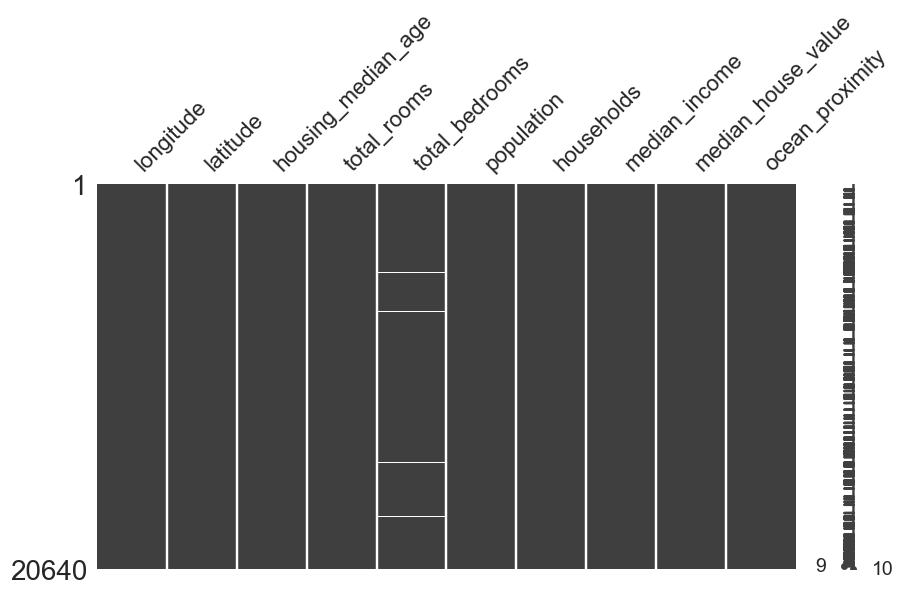

In [7]:
# A bar chart visualization of the nullity of the given DataFrame.
msno.matrix(data_housing, figsize=(10, 5));

In [8]:
data_housing.describe(include="all")

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,<1H OCEAN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9136
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909,NaN
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874,NaN
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000,NaN
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000,NaN
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000,NaN
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000,NaN


### Target analysis

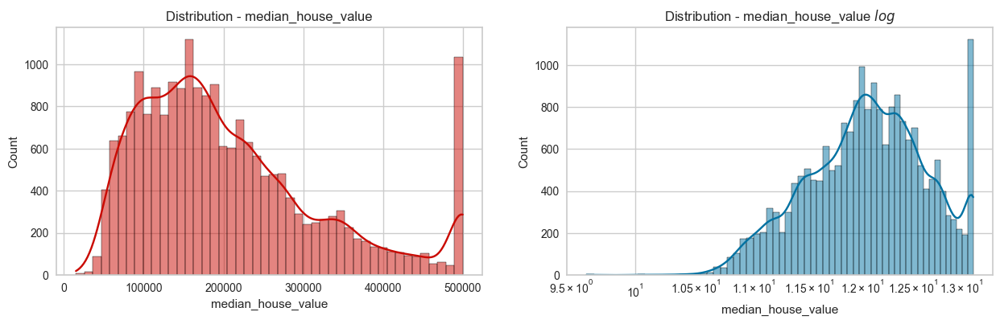

In [9]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 4))

sns.histplot(data_housing[TARGET_NAME], color="r", kde=True, ax=axes[0])
axes[0].set_title(f"Distribution - {TARGET_NAME}")

sns.histplot(np.log(data_housing[TARGET_NAME]), color="b", kde=True, ax=axes[1])  #box-cox
axes[1].set_title(f"Distribution - {TARGET_NAME} $log$")
axes[1].set_xscale('log');

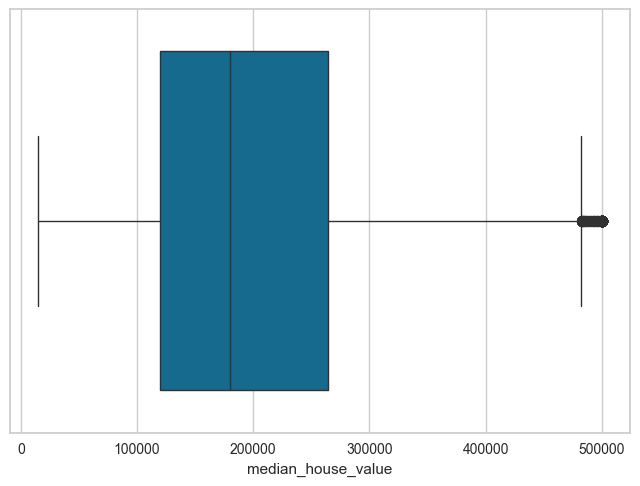

In [10]:
sns.boxplot(data_housing[TARGET_NAME], orient="h");

### Categorical features

In [11]:
data_housing["ocean_proximity"].value_counts(dropna=False)

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64

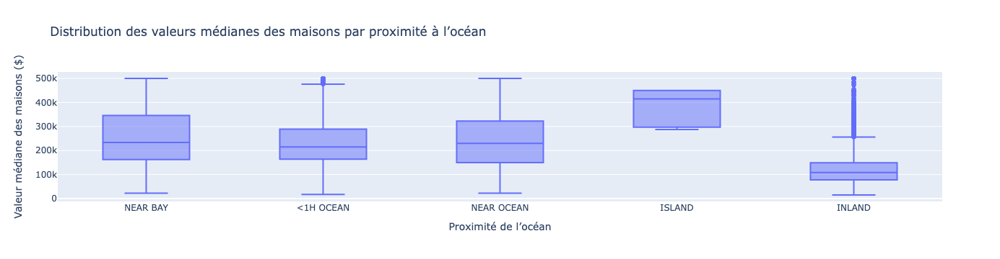

In [12]:
fig = px.box(
    data_housing,
    x="ocean_proximity",
    y=TARGET_NAME,
    category_orders={"ocean_proximity": ["NEAR BAY", "<1H OCEAN", "NEAR OCEAN", "ISLAND", "INLAND"]},
    title="Distribution des valeurs médianes des maisons par proximité à l’océan",
    labels={
        "ocean_proximity": "Proximité de l’océan",
        TARGET_NAME: "Valeur médiane des maisons ($)"
    }
)
fig.show()


### Numeric variables

In [13]:
num_columns = list(data_housing.drop(TARGET_NAME, axis=1).select_dtypes(include=[int, float]).columns) # extraction des colonnes numériques/décimales sans la variable cible
logger.info(f"Numeric columns : {num_columns}")

2025-09-30 10:02:00.496 | INFO     | __main__:<module>:2 - Numeric columns : ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']


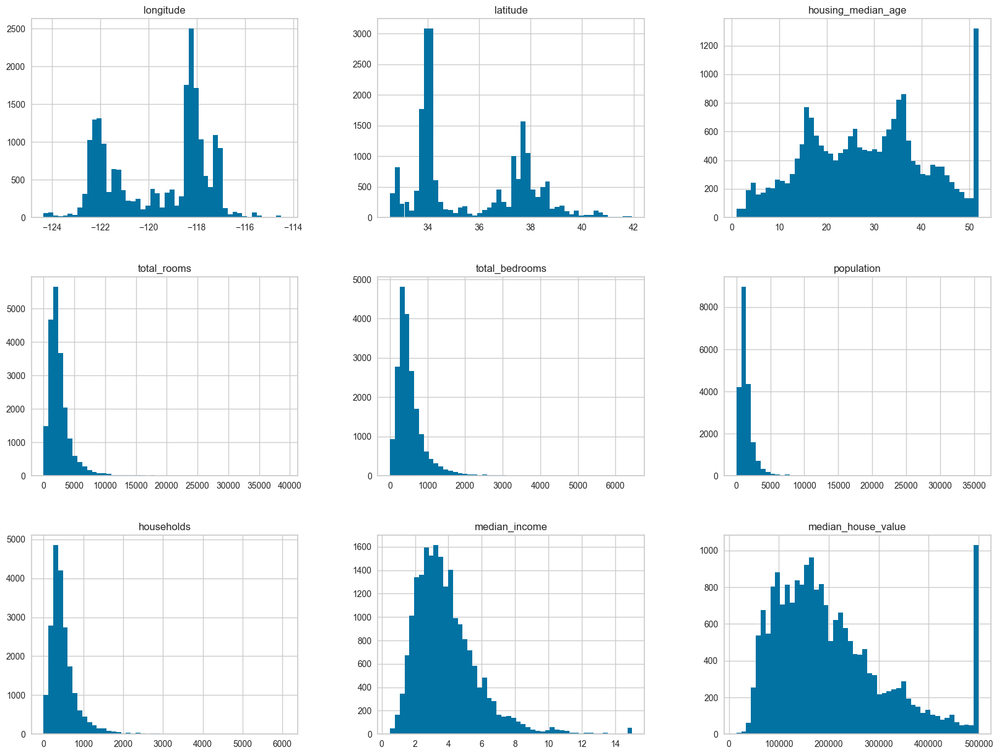

In [15]:
# Numerics distribution
data_housing.hist(bins=50, figsize=(20, 15));

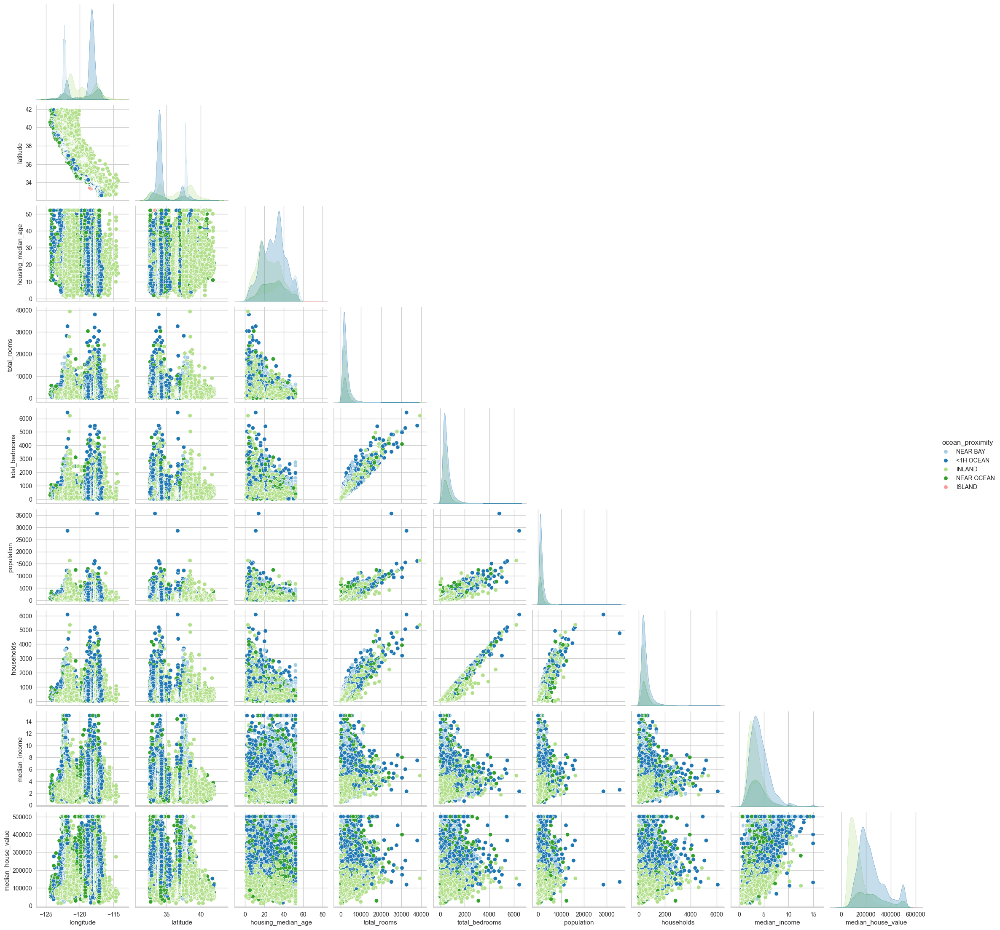

In [16]:
sns.pairplot(data_housing, diag_kind="kde", hue="ocean_proximity", palette="Paired", corner=True) # vue d’ensemble

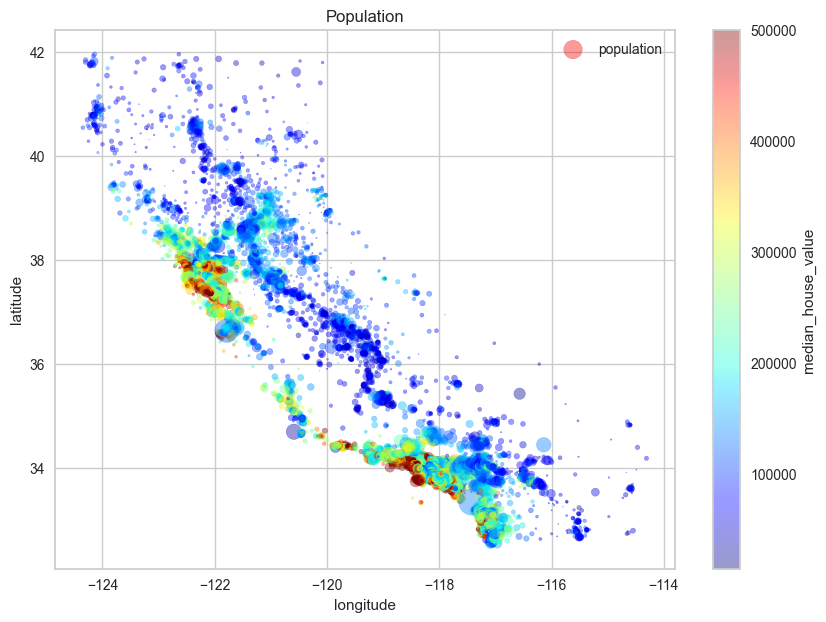

In [17]:
data_housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4,
                  s=data_housing["population"] / 100, label="population", figsize=(10,7),
                  c="median_house_value", cmap=plt.get_cmap("jet"), colorbar=True,
                  sharex=False, title="Population")
plt.legend()

In [18]:
import folium
from folium.plugins import MarkerCluster
import branca.colormap as cm

# Créer une carte centrée sur la Californie
m = folium.Map(location=[37, -119], zoom_start=6, tiles="cartodbpositron")

# Créer un cluster pour éviter le surchargement
marker_cluster = MarkerCluster().add_to(m)

# Normaliser les valeurs pour les couleurs
colormap = cm.linear.YlOrRd_09.scale(data_housing["median_house_value"].min(),
                                     data_housing["median_house_value"].max())
colormap.caption = "Median House Value"
colormap.add_to(m)

# Ajouter les points
for _, row in data_housing[["latitude", "longitude", "population", TARGET_NAME]].iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=max(row["population"]/10000, 2),  # taille ~ population
        color=colormap(row[TARGET_NAME]),
        fill=True,
        fill_opacity=0.6,
        popup=folium.Popup(
            f"<b>Median house value:</b> ${row[TARGET_NAME]:,}<br>"
            f"<b>Population:</b> {row["population"]:,}", max_width=250
        )
    ).add_to(marker_cluster)

m

### Data profiling

In [20]:
# To do : générer l'analyse univariée et bivariée avec ydata_profiling
from ydata_profiling import ProfileReport

# profile = ProfileReport("to be replaced")

# profile.to_file(Path(REPORT_DIR, "house_price_profiling.html"))

## Modeling

### Feature combinations

In [21]:
data_housing = data_housing.assign(rooms_per_household=lambda dfr: dfr["total_rooms"] / dfr["households"],  # rapport nombre total de pièces / nombre de ménages
                                   bedrooms_per_room=lambda dfr: dfr["total_bedrooms"] / dfr["total_rooms"], # proportion de chambres parmi les pièces
                                   population_per_household=lambda dfr: dfr["population"] / dfr["households"] # nombre moyen de personnes par ménage
                                  )

In [22]:
data_housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,8.288136,0.129516,2.802260
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,5.817352,0.184458,2.547945
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,6.281853,0.172096,2.181467


In [23]:
corr_matrix = data_housing.drop("ocean_proximity", axis=1).corr()
corr_matrix["median_house_value"].sort_values(ascending=False)

median_house_value          1.000000
median_income               0.688075
rooms_per_household         0.151948
total_rooms                 0.134153
housing_median_age          0.105623
households                  0.065843
total_bedrooms              0.049686
population_per_household   -0.023737
population                 -0.024650
longitude                  -0.045967
latitude                   -0.144160
bedrooms_per_room          -0.255880
Name: median_house_value, dtype: float64

In [24]:
# Scatter plot between median_house_value et rooms_per_household
fig = px.scatter(
    data_housing,
    x="rooms_per_household",
    y=TARGET_NAME,
    opacity=0.2,
    labels={
        "rooms_per_household": "Rooms per Household",
        TARGET_NAME: "Median House Value"
    },
    title="Relationship between Rooms per Household and Median House Value"
)
fig.show()

### Train / test split

In [25]:
X_features = data_housing.drop(TARGET_NAME, axis=1)  # features
y_target = data_housing.loc[:, TARGET_NAME]  # target

In [26]:
X_features.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,NEAR BAY,6.984127,0.146591,2.555556
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,NEAR BAY,6.238137,0.155797,2.109842
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,NEAR BAY,8.288136,0.129516,2.802260
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,NEAR BAY,5.817352,0.184458,2.547945
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,NEAR BAY,6.281853,0.172096,2.181467


In [27]:
y_target.head()

0    452600.0
1    358500.0
2    352100.0
3    341300.0
4    342200.0
Name: median_house_value, dtype: float64

In [28]:
# Séparons nos données en un jeu d'entraînement et un jeu de test :
# 30% des données dans le jeu de test
X_train, X_test, y_train, y_test = train_test_split(X_features, y_target, test_size=0.3, random_state=RANDOM_STATE)

print(f"Train set - X: {X_train.shape} ; y: {y_train.shape} \nTest set - X: {X_test.shape} ; y: {y_test.shape}")

Train set - X: (14448, 12) ; y: (14448,) 
Test set - X: (6192, 12) ; y: (6192,)


### Handling numeric features

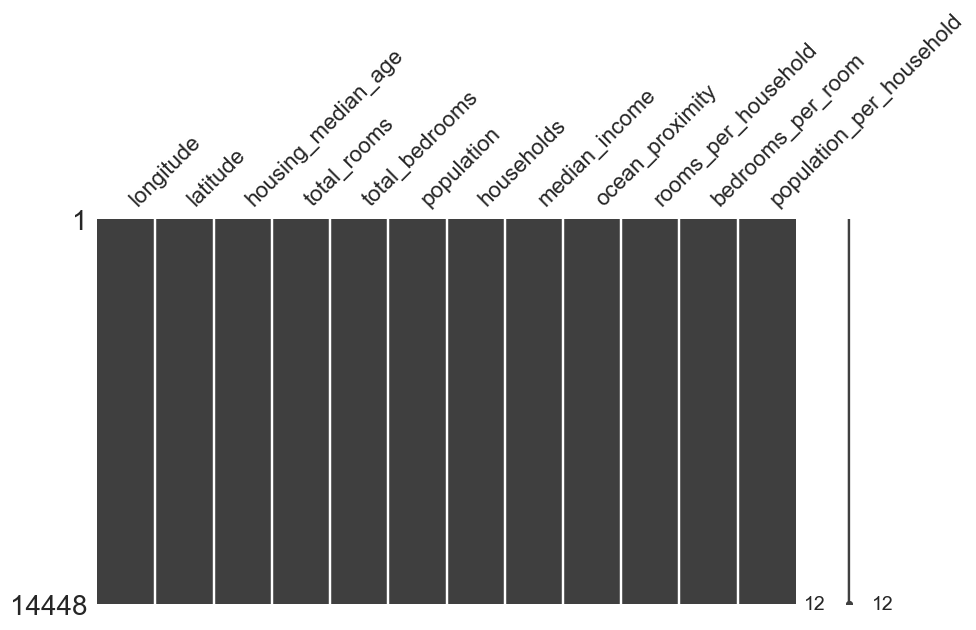

In [29]:
msno.matrix(X_train, figsize=(10, 5));

**2 numerical features** contain empty values (total_bedrooms and bedroms_per_room). Let's test imputation using the median!

In [30]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy="median")

In [31]:
imputer.fit(X_train.select_dtypes(include="number"))

,missing_values,nan
,strategy,'median'
,fill_value,None
,copy,True
,add_indicator,False
,keep_empty_features,False


In [32]:
imputer.statistics_

array([-1.18510000e+02,  3.42700000e+01,  2.90000000e+01,  2.13100000e+03,
        4.37000000e+02,  1.16800000e+03,  4.11000000e+02,  3.53910000e+00,
        5.23242240e+00,  2.02985041e-01,  2.81714686e+00])

In [33]:
# Check that this is the same as manually computing the median of each attribute:
X_train.select_dtypes(include="number").median().values

array([-1.18510000e+02,  3.42700000e+01,  2.90000000e+01,  2.13100000e+03,
        4.37000000e+02,  1.16800000e+03,  4.11000000e+02,  3.53910000e+00,
        5.23242240e+00,  2.02985041e-01,  2.81714686e+00])

Let's test normalization using the MinMaxScaler!

In [34]:
MinMaxScaler().fit_transform(X_train.select_dtypes(include="number"))  # Standardize features

array([[0.63047809, 0.14680851, 0.66666667, ..., 0.03540957, 0.07314815,
        0.00184525],
       [0.72310757, 0.02553191, 0.37254902, ..., 0.02490651, 0.16068611,
        0.00106371],
       [0.41932271, 0.21702128, 0.45098039, ..., 0.03353176, 0.0845999 ,
        0.00150696],
       ...,
       [0.59462151, 0.15744681, 0.68627451, ..., 0.02196727, 0.1898038 ,
        0.00212431],
       [0.23804781, 0.53510638, 0.2745098 , ..., 0.03904731, 0.07443667,
        0.00200105],
       [0.19223108, 0.55531915, 1.        , ..., 0.01782502, 0.23463217,
        0.00113982]])

### Handling Categorical features

In [35]:
housing_cat = data_housing.select_dtypes(include="object")
housing_cat.head()

,ocean_proximity
0,NEAR BAY
1,NEAR BAY
2,NEAR BAY
3,NEAR BAY
4,NEAR BAY


In [36]:
from sklearn.preprocessing import OrdinalEncoder, TargetEncoder, OneHotEncoder

cat_encoder = OneHotEncoder(sparse_output=False)
housing_cat_1hot = cat_encoder.fit_transform(housing_cat)
housing_cat_1hot

array([[0., 0., 0., 1., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 1., 0.],
       ...,
       [0., 1., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [0., 1., 0., 0., 0.]])

In [37]:
cat_encoder.categories_

[array(['<1H OCEAN', 'INLAND', 'ISLAND', 'NEAR BAY', 'NEAR OCEAN'],
       dtype=object)]

In [39]:
# If the variable were ordinal, then we could use OrdinalEncoder, specifying the order between the modalities.
ordinal_encoder = OrdinalEncoder(categories=[["NEAR BAY", "<1H OCEAN", "NEAR OCEAN", "ISLAND", "INLAND"]])
housing_cat_encoded = ordinal_encoder.fit_transform(housing_cat)
housing_cat_encoded[:10]

array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.]])

Lorsqu’on prépare les données, il est important de ne pas “contaminer” le modèle en utilisant des informations issues du jeu de test. Pour cela, toutes les étapes de transformation (imputation, standardisation, encodage, etc.) doivent **être apprises uniquement sur le jeu d’entraînement** puis **appliquées aux jeux de validation et de test**. Les **pipelines de scikit-learn** permettent d’automatiser ce processus, de réduire les erreurs et de rendre le code plus clair et reproductible.

### Preprocessing

In [40]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline


In [41]:
# Numeric features
num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")),
        ('std_scaler', StandardScaler()),
    ])

# OneHot : catégorical features
onehot_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='undefined')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

In [42]:
data_housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,8.288136,0.129516,2.802260
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,5.817352,0.184458,2.547945
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,6.281853,0.172096,2.181467


In [43]:
num_features = ["housing_median_age", "total_rooms", "total_bedrooms", "population",
                "households", "median_income"]
# alternative: if you want to use all numerical columns data_housing.select_dtypes(include=["float", "int"]).columns
cat_features = ["ocean_proximity"]  # alternative: data_housing.select_dtypes(include="objetc")

preprocess_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_features),
        ("cat", OneHotEncoder(), cat_features),
    ])

In [44]:
logger.info(f"Data shape before preprocessing: {data_housing.loc[:, num_features + cat_features].shape}")
housing_prepared = preprocess_pipeline.fit_transform(data_housing)
logger.info(f"Data shape before preprocessing: {housing_prepared.shape}")

2025-09-30 10:05:41.870 | INFO     | __main__:<module>:1 - Data shape before preprocessing: (20640, 7)
2025-09-30 10:05:42.520 | INFO     | __main__:<module>:3 - Data shape before preprocessing: (20640, 11)


In [45]:
housing_prepared

array([[ 0.98214266, -0.8048191 , -0.97247648, ...,  0.        ,
         1.        ,  0.        ],
       [-0.60701891,  2.0458901 ,  1.35714343, ...,  0.        ,
         1.        ,  0.        ],
       [ 1.85618152, -0.53574589, -0.82702426, ...,  0.        ,
         1.        ,  0.        ],
       ...,
       [-0.92485123, -0.17499526, -0.12360781, ...,  0.        ,
         0.        ,  0.        ],
       [-0.84539315, -0.35559977, -0.30482697, ...,  0.        ,
         0.        ,  0.        ],
       [-1.00430931,  0.06840827,  0.18875678, ...,  0.        ,
         0.        ,  0.        ]])

### Train a linear model

In [46]:
from sklearn.linear_model import LinearRegression

pipe_lin_reg = Pipeline(steps=[
    ('preprocessor', preprocess_pipeline),
    ('regressor', LinearRegression())
])

# On entraîne ce modèle sur les données d'entrainement
pipe_lin_reg.fit(X_train, y_train)

,steps,"[('preprocessor', ...), ('regressor', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('num', ...), ('cat', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [47]:
# Prediction sur le jeu de données test comme baseline
y_test_pred = pipe_lin_reg.predict(X_test)


def get_regression_metrics(y_true, y_pred):
    """Compute regression performance metircs.

    Args:
        y_true : array-like of shape (n_samples,) or (n_samples, n_outputs)
            Ground truth (correct) target values.

        y_pred : array-like of shape (n_samples,) or (n_samples, n_outputs)
            Estimated target values.
    
    Returns:
        Dict[str, float]:
            mse: mean squared error
            rmse: root mean squared error
            mae: Mean absolute error
            mape: mean absolute percentage error (MAPE) in %
            r2: coefficient of determination in %.
    """
    
    # Metriques
    mse = metrics.mean_squared_error(y_true, y_pred)
    rmse = metrics.root_mean_squared_error(y_true, y_pred)
    mae = metrics.mean_absolute_error(y_true, y_pred)
    mape = round(100 * metrics.mean_absolute_percentage_error(y_true, y_pred), 2)
    r2 = round(100 * metrics.r2_score(y_true, y_pred), 2)
    return {
        "mse": mse,
        "rmse": rmse,
        "mae": mae,
        "mape": mape,
        "r2": r2,
    }

y_test_metrics = get_regression_metrics(y_test, y_test_pred)
y_test_metrics

{'mse': 4872308922.487822,
 'rmse': 69801.92635227069,
 'mae': 50722.934106119195,
 'mape': 28.91,
 'r2': 62.88}

In [48]:
get_regression_metrics(y_train, pipe_lin_reg.predict(X_train))

{'mse': 4886797029.433804,
 'rmse': 69905.62945452821,
 'mae': 50453.66468533296,
 'mape': 28.59,
 'r2': 63.52}

In [49]:
pipe_lin_reg.feature_names_in_

array(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'ocean_proximity', 'rooms_per_household', 'bedrooms_per_room',
       'population_per_household'], dtype=object)

In [50]:
print("Intercept:", pipe_lin_reg[-1].intercept_)
print("Coefficients:", pipe_lin_reg[-1].coef_)

Intercept: 247749.5228880466
Coefficients: [ 15283.20035674 -15465.95217286  35470.25456329 -41675.86739489
  27480.75169446  77005.1543371  -20599.52391629 -89841.631313
 136578.27310166 -17719.09181713  -8418.02605523]


#### Significance of coefficients

In [51]:
data_housing.iloc[y_train.index]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,bedrooms_per_room,population_per_household
7061,-118.02,33.93,35.0,2400.0,398.0,1218.0,408.0,4.1312,193800.0,<1H OCEAN,5.882353,0.165833,2.985294
14689,-117.09,32.79,20.0,2183.0,534.0,999.0,496.0,2.8631,169700.0,NEAR OCEAN,4.401210,0.244617,2.014113
17323,-120.14,34.59,24.0,1601.0,282.0,731.0,285.0,4.2026,259800.0,NEAR OCEAN,5.617544,0.176140,2.564912
10056,-121.00,39.26,14.0,810.0,151.0,302.0,138.0,3.1094,136100.0,INLAND,5.869565,0.186420,2.188406
15750,-122.45,37.77,52.0,3188.0,708.0,1526.0,664.0,3.3068,500001.0,NEAR BAY,4.801205,0.222083,2.298193
...,...,...,...,...,...,...,...,...,...,...,...,...,...
11284,-117.96,33.78,35.0,1330.0,201.0,658.0,217.0,6.3700,229200.0,<1H OCEAN,6.129032,0.151128,3.032258
11964,-117.43,34.02,33.0,3084.0,570.0,1753.0,449.0,3.0500,97800.0,INLAND,6.868597,0.184825,3.904232
5390,-118.38,34.03,36.0,2101.0,569.0,1756.0,527.0,2.9344,222100.0,<1H OCEAN,3.986717,0.270823,3.332068
860,-121.96,37.58,15.0,3575.0,597.0,1777.0,559.0,5.7192,283500.0,<1H OCEAN,6.395349,0.166993,3.178891


In [52]:
# Instanciation:
reg_lin = smf.ols(f"{TARGET_NAME} ~ housing_median_age + total_rooms + total_bedrooms + population + households + median_income + ocean_proximity",
                  data=data_housing.loc[y_train.index], )

# Calculs:
res_lin = reg_lin.fit()
res_lin.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     median_house_value   R-squared:                       0.635
Model:                            OLS   Adj. R-squared:                  0.635
Method:                 Least Squares   F-statistic:                     2514.
Date:                Tue, 30 Sep 2025   Prob (F-statistic):               0.00
Time:                        10:05:47   Log-Likelihood:            -1.8167e+05
No. Observations:               14448   AIC:                         3.634e+05
Df Residuals:                   14437   BIC:                         3.634e+05
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                      2.526e+04   2921.099      8.648      0.000    1.95e+04     3.1e+04
ocean_proximity[T.INLAND]     -6.924e+04   1492.134    -46.405      0.000   -7.22e+04   -6.63e+04
ocean_proximity[T.ISLAND]      1.572e+05    3.5e+04      4.491      0.000    8.86e+04    2.26e+05
ocean_proximity[T.NEAR BAY]    2880.4321   2010.288      1.433      0.152   -1059.991    6820.855
ocean_proximity[T.NEAR OCEAN]  1.218e+04   1876.908      6.490      0.000    8502.517    1.59e+04
housing_median_age             1211.6833     52.846     22.929      0.000    1108.099    1315.268
total_rooms                      -7.1503      0.960     -7.445      0.000      -9.033      -5.268
total_bedrooms                   84.4988      8.322     10.154      0.000      68.187     100.810
population                      -36.5518      1.267    -28.839      0.000     -39.036     -34.068
households                       71.9000      9.042      7.952      0.000      54.177      89.623
median_income                  4.043e+04    404.313     99.987      0.000    3.96e+04    4.12e+04
==============================================================================
Omnibus:                     3543.711   Durbin-Watson:                   1.974
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            13420.054
Skew:                           1.186   Prob(JB):                         0.00
Kurtosis:                       7.082   Cond. No.                     2.37e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.37e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Significance of coefficients in the linear model:
- **If p-value < 0.05** → reject H0, the coefficient is statistically significant.
- **If p-value > 0.05** → no evidence that the coefficient is different from zero.

#### Prediction analysis

In [53]:
y_train_pred = pipe_lin_reg.predict(X_train)
y_test_pred = pipe_lin_reg.predict(X_test)

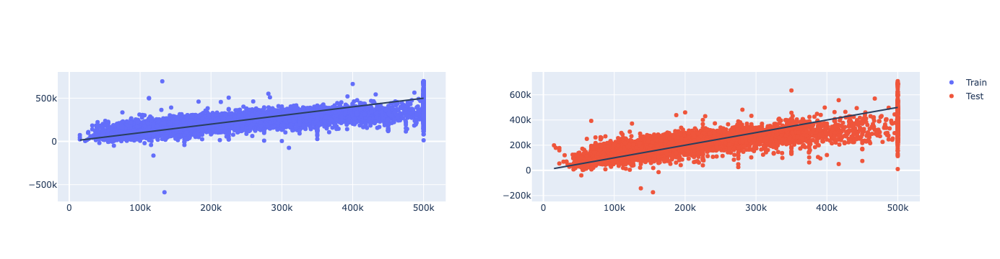

In [54]:
fig = make_subplots(rows=1, cols=2, shared_yaxes=False)

for idx, (name, y_true, y_pred) in enumerate([("Train", y_train, y_train_pred),
                                              ("Test", y_test, y_test_pred),
                                             ]):
    col = idx + 1
    fig.add_trace(go.Scatter(x=y_true, y=y_pred, mode="markers", name=name), row=1, col=col)

    fig.add_shape(type="line",
              x0=y_true.min(), x1=y_true.max(),
              y0=y_true.min(), y1=y_true.max(),
              row=1, col=col)
    
fig.show()

#### Residual analysis

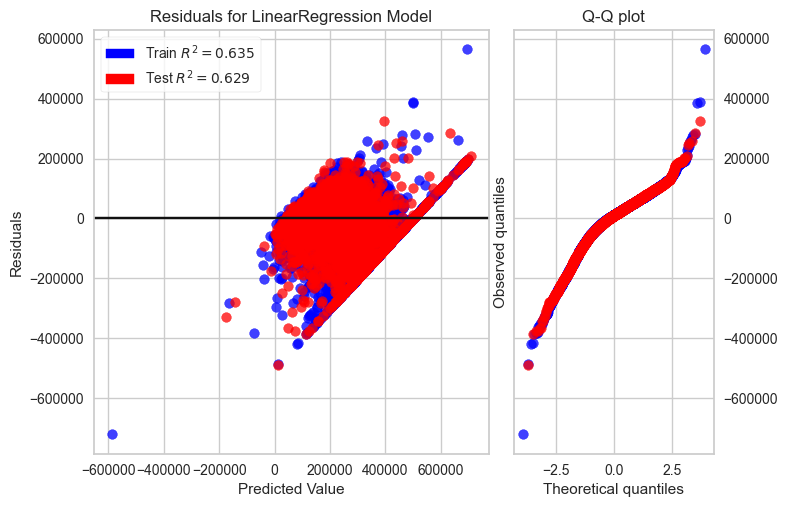

<Figure size 800x550 with 0 Axes>

In [55]:
res_viz = ResidualsPlot(pipe_lin_reg,
                        is_fitted="auto",
                        qqplot=True,
                        hist=False,
                        train_color="blue",
                        test_color="red",
                       )
res_viz.fit(X_train, y_train)
res_viz.score(X_test, y_test)
res_viz.show(clear_figure=True);

#### Hypothesis testing

In [56]:
# La moyenne des residus est:
res_lin.resid.mean()

np.float64(2.8906259603245576e-08)

##### Normality

Une p-value < alpha (5%, en général) pour le test d'Anderson-Darling indique que l'hypothèse nulle de normalité de la distribution des résidus est rejetée.

In [57]:
print("La p-value du test d'Aderson-Darling vaux", normal_ad(res_lin.resid)[1])

La p-value du test d'Aderson-Darling vaux 0.0


La p-value du test d'Aderson-Darling vaux 0.0
Ici, l'hypothèse H0 est rejetée puisque la p-value obtenue est inférieure à 5%, les résidus ne suivent pas une distribution Normale.

##### Homoscedasticite
Test de White

- L'hypothèse nulle (H0): est qu'il y a homoscédasticité (les résidus sont dispersés aléatoirement, la variance d'un individu à un autre est constante)
- L'hypothèse alternative (H1): est qu'il y a hétéroscédasticité.

In [58]:
# Homoscedasticite:
white_test = het_white(res_lin.resid, res_lin.model.exog)
labels_white_test = ["Test Statistic", "p-value", "F-Statistic", "F-Test p-value"]
print(dict(zip(labels_white_test, white_test)))

{'Test Statistic': np.float64(3393.0289558041454), 'p-value': np.float64(0.0), 'F-Statistic': np.float64(84.96465182867342), 'F-Test p-value': np.float64(0.0)}


On fixe un seuil alpha de 5 %, la p-value est ici inférieure au seuil, on ne peut pas accepter l'hypothèse nulle d'homoscédasticité.

##### Multicolinéarité
La multicolinéarité se produit lorsque les variables indépendantes sont trop fortement corrélées entre elles.

Le facteur d'inflation de la variance VIF* identifie la corrélation entre les variables indépendantes et la force de cette corrélation.
- VIF ≈ 1 : pas de multicolinéarité
- 1 < VIF < 5 → corrélation modérée, mais acceptable.
- 5 ≤ VIF < 10 → multicolinéarité notable, à surveiller.
- VIF > 10 : multicolinéarité sévère

In [59]:
# Check for Multicollinearity
# Variance Inflation Factor (VIF)
r_square_test = metrics.r2_score(y_test, pipe_lin_reg.predict(X_test))

vif = 1 / (1 - r_square_test)
vif

2.693877027698142

#### Cross validation

In [60]:
scores = cross_validate(pipe_lin_reg, X_train, y_train,
                        cv=5,
                        scoring=["r2"],  # ["r2", "neg_root_mean_squared_error"]
                        return_train_score=True,
                        verbose=True,
                       )
scores

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.1s finished


{'fit_time': array([0.0126698 , 0.0116899 , 0.01032305, 0.0112319 , 0.01130676]),
 'score_time': array([0.00276589, 0.00193834, 0.00197387, 0.00208807, 0.00281906]),
 'test_r2': array([0.63548754, 0.62386766, 0.65299175, 0.63950233, 0.61138557]),
 'train_r2': array([0.63501874, 0.63760301, 0.63050262, 0.63400579, 0.64017711])}

In [61]:
pd.DataFrame(scores)


,fit_time,score_time,test_r2,train_r2
0,0.012670,0.002766,0.635488,0.635019
1,0.011690,0.001938,0.623868,0.637603
2,0.010323,0.001974,0.652992,0.630503
3,0.011232,0.002088,0.639502,0.634006
4,0.011307,0.002819,0.611386,0.640177


#### Optimization

**Hyperparameters tuning**

Le réglage des hyperparamètres (hyperparameter tuning en anglais) est une étape importante dans le développement de modèles de machine learning. Les hyperparamètres sont des paramètres qui ne sont pas appris par le modèle lui-même, mais qui doivent être spécifiés avant l'entraînement du modèle. Ils contrôlent le comportement et les performances du modèle.

Il est important de noter que le réglage des hyperparamètres est un processus itératif et peut nécessiter plusieurs itérations pour trouver la meilleure combinaison. Des techniques avancées telles que l'optimisation bayésienne (**sklearn**, **optuna**, **hyperopt**, **Tune**, **BayesianOptimization**), la recherche aléatoire (RandomizedSearchCV), les algorithmes génétiques, etc., peuvent également être utilisées pour explorer efficacement l'espace des hyperparamètres.

Nous allons, pour la suite, tester l'optimisation des hyperparamètres avec **sklearn**.


Voici quelques étapes générales pour le réglage des hyperparamètres :

- **Sélection des hyperparamètres** : Tout d'abord, identifiez les hyperparamètres pertinents pour votre modèle. Cela dépendra du type de modèle que vous utilisez. Par exemple, pour un modèle de régression linéaire, le coefficient de régularisation (alpha) peut être un hyperparamètre important, tandis que pour un modèle de forêt aléatoire, le nombre d'arbres (n_estimators) et la profondeur maximale des arbres (max_depth) peuvent être des hyperparamètres clés.

- **Définition de la grille de recherche** : Pour chaque hyperparamètre sélectionné, définissez une plage de valeurs possibles ou une liste de valeurs spécifiques à tester. Il est courant d'utiliser une approche de recherche par grille (grid search) où toutes les combinaisons possibles d'hyperparamètres sont évaluées. Cependant, d'autres méthodes d'optimisation, telles que l'optimisation bayésienne, peuvent également être utilisées.

- **Évaluation des performances** : Définissez une métrique d'évaluation appropriée pour mesurer les performances du modèle, comme l'exactitude (accuracy), la précision (precision), le rappel (recall), le F-mesure (F1-score), etc. Cette métrique sera utilisée pour comparer les performances des modèles avec différents réglages d'hyperparamètres.

- **Entraînement et évaluation des modèles** : Pour chaque combinaison d'hyperparamètres dans la grille de recherche, entraînez le modèle sur les données d'entraînement et évaluez ses performances sur les données de validation à l'aide de la métrique d'évaluation choisie. Ceci est généralement fait en utilisant la validation croisée (cross-validation) pour obtenir une estimation plus fiable des performances.

- **Sélection des meilleurs hyperparamètres** : Une fois que tous les modèles ont été évalués, comparez les performances et identifiez la combinaison d'hyperparamètres qui donne les meilleurs résultats selon la métrique d'évaluation choisie. C'est cette combinaison qui sera utilisée comme les hyperparamètres finaux pour le modèle.

- **Test final et évaluation** : Une fois que vous avez sélectionné les meilleurs hyperparamètres, entraînez le modèle sur l'ensemble des données d'entraînement, y compris les données de validation, et évaluez-le sur un ensemble de test indépendant pour obtenir une estimation finale de ses performances.

In [62]:
# Definir les hyperparamètres à optimiser ainsi que la grille des valeurs
# Ici, on teste uniquement le paramètre fit_intercept :
# True → le modèle apprend une constante (intercept). False → le modèle est entrainé sans constante.

lr_param_grid = {
    "regressor__fit_intercept": [True, False],
}

grid_search = GridSearchCV(pipe_lin_reg, # Pipeline à optimiser
                           lr_param_grid, # Grid des hyperparamètres
                           cv=5, # Validation croisée avec 5 folds
                           scoring="r2", # Métrique à optimiser
                           return_train_score=True, # En plus des scores sur le jeu de validation, retourner également ceux du train
                          )
grid_search

,estimator,Pipeline(step...egression())])
,param_grid,"{'regressor__fit_intercept': [True, False]}"
,scoring,'r2'
,n_jobs,None
,refit,True
,cv,5
,verbose,0
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,True
,transformers,"[('num', ...), ('cat', ...)]"


In [63]:
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
logger.info(f"Best params: {best_params}")

2025-09-30 10:05:50.116 | INFO     | __main__:<module>:4 - Best params: {'regressor__fit_intercept': True}


In [64]:
logger.info(f"Internal CV score: {grid_search.best_score_: .3f}")

2025-09-30 10:05:50.121 | INFO     | __main__:<module>:1 - Internal CV score:  0.633


In [65]:
grid_cv_results = grid_search.cv_results_
pd.DataFrame(grid_cv_results)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_regressor__fit_intercept,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.012853,0.003169,0.002420,0.000454,True,{'regressor__fit_intercept': True},0.635488,0.623868,0.652992,0.639502,0.611386,0.632647,0.014129,1,0.635019,0.637603,0.630503,0.634006,0.640177,0.635461,0.003278
1,0.012663,0.002941,0.003059,0.000832,False,{'regressor__fit_intercept': False},0.635488,0.623868,0.652992,0.639502,0.611386,0.632647,0.014129,2,0.635019,0.637603,0.630503,0.634006,0.640177,0.635461,0.003278


#### Analyze the best model

In [66]:
lr_best_model = grid_search.best_estimator_
lr_best_model

,steps,"[('preprocessor', ...), ('regressor', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('num', ...), ('cat', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [67]:
logger.info(f"Train metrics: \n{get_regression_metrics(y_train, lr_best_model.predict(X_train))}")

2025-09-30 10:05:50.153 | INFO     | __main__:<module>:1 - Train metrics: 
{'mse': 4886797029.433804, 'rmse': 69905.62945452821, 'mae': 50453.66468533296, 'mape': 28.59, 'r2': 63.52}


In [68]:
y_test_metrics = get_regression_metrics(y_test, lr_best_model.predict(X_test))

logger.info(f"Train metrics: \n{y_test_metrics}")

2025-09-30 10:05:50.160 | INFO     | __main__:<module>:3 - Train metrics: 
{'mse': 4872308922.487822, 'rmse': 69801.92635227069, 'mae': 50722.934106119195, 'mape': 28.91, 'r2': 62.88}


In [71]:
# Feature importances

df_feature_importance_lr = pd.DataFrame({
    "Feature": lr_best_model[0].get_feature_names_out(),
    "Coefficient": lr_best_model[-1].coef_,
})
df_feature_importance_lr

,Feature,Coefficient
0,num__housing_median_age,15283.200357
1,num__total_rooms,-15465.952173
2,num__total_bedrooms,35470.254563
3,num__population,-41675.867395
4,num__households,27480.751694
5,num__median_income,77005.154337
6,cat__ocean_proximity_<1H OCEAN,-20599.523916
7,cat__ocean_proximity_INLAND,-89841.631313
8,cat__ocean_proximity_ISLAND,136578.273102
9,cat__ocean_proximity_NEAR BAY,-17719.091817


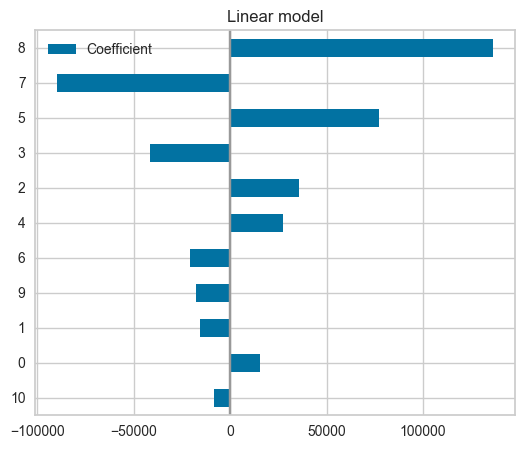

In [72]:
# top important features
(df_feature_importance_lr
 .sort_values("Coefficient", key=lambda v: abs(v), ascending=True)
 .plot(kind="barh", figsize=(8, 5))
)
plt.title("Linear model")
plt.axvline(x=0, color='.6')
plt.subplots_adjust(left=.3);

#### Model persistence using dill

In [73]:
# Sauvegarde du modèle
with open(Path(MODEL_DIR, "lr_best_model.dill"), "wb") as f:
    dill.dump(lr_best_model, f)

### Exercices

Essayez différents modèles de régression régularisée avec scikit-learn :

- **Ridge** (sklearn.linear_model.Ridge) en testant plusieurs valeurs de l’hyperparamètre `alpha` et `fit_intercept`.
- **Lasso** (sklearn.linear_model.Lasso) en testant plusieurs valeurs de l’hyperparamètre `alpha` et `fit_intercept`.
- **ElasticNet** (sklearn.linear_model.ElasticNet) en testant différentes combinaisons de `alpha`,  `l1_ratio` et `fit_intercept`.
- **Choisir le meilleur modèle** parmi Linear regression, Ridge, Lasso et ElasticNet


**Questions optionnelles**
- **Question OP1**: Essayez de remplacer `GridSearchCV` par `RandomizedSearchCV` pour optimiser le meilleur modèle obtenu précédemment.
- **Question OP2**: Essayez d'ajouter un transformateur dans le pipeline de préparation afin de ne sélectionner que les features les plus importants.
- **Question OP3**: Explorez automatiquement certaines options de préparation à l'aide de `GridSearchCV`.

In [77]:
session_info.show()

Félicitations ! Vous en savez déjà beaucoup sur l'apprentissage automatique. :)